In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


In [2]:
gdf = gpd.read_file("./MEX/MEX_ADM2_fixedInternalTopology.shp")
gdf = gdf[['shapeID', 'geometry']]
gdf.head()

,shapeID,geometry
0,MEX-ADM2-1590546715-B1,"POLYGON ((-101.99941 22.21951, -101.99940 22.2..."
1,MEX-ADM2-1590546715-B2,"POLYGON ((-102.27355 22.08805, -102.27320 22.0..."
2,MEX-ADM2-1590546715-B3,"POLYGON ((-102.18902 22.36244, -102.18951 22.3..."
3,MEX-ADM2-1590546715-B4,"POLYGON ((-102.35385 22.12064, -102.35426 22.1..."
4,MEX-ADM2-1590546715-B5,"POLYGON ((-102.32431 21.93627, -102.32438 21.9..."


In [4]:
match = pd.read_csv("./gB_IPUMS_match.csv")
match = match[['shapeID', 'MUNI2015']]
ref_dict = dict(zip(match['MUNI2015'], match['shapeID']))
match.head()

df = pd.read_csv("./mexico2010.csv")
df = df[['GEO2_MX', 'sum_income', 'total_pop', 'unrel_ppl', 'perc_urban', 'sum_num_intmig']]
df['GEO2_MX'] = df['GEO2_MX'].astype(str).str.replace("484", "").astype(int).map(ref_dict)
df = df.rename(columns = {'GEO2_MX': 'shapeID'})
df.head()

,shapeID,sum_income,total_pop,unrel_ppl,perc_urban,sum_num_intmig
0,MEX-ADM2-1590546715-B7,22382867663,849101.0,0.018720,0.892990,42055.0
1,MEX-ADM2-1590546715-B1,3998425640,45951.0,0.006768,0.269853,4017.0
2,MEX-ADM2-1590546715-B10,3045860068,53142.0,0.011385,0.493884,11992.0
3,MEX-ADM2-1590546715-B11,3449277596,14302.0,0.000839,0.367221,762.0
4,MEX-ADM2-1590546715-B5,3028539049,100150.0,0.019251,0.669675,7551.0


In [67]:
import matplotlib.pyplot as plt


In [6]:
# class Sage(torch.nn.Module):

#     def __init__(self, embed_dim, feature_dim, num_classes, K): 
#         super(Sage, self).__init__()

In [108]:
class SpatialGraph():

    def __init__(self, target_id, gdf, df, degrees = 1):
        self.target_id = target_id
        self.gdf = gdf
        self.degrees = degrees
        self.df = df
        self.degree_dict = {}
        self.neighbors = self.__get_spatial_neighbors()
        self.x = self.__get_x()
        self.neighbors_recoded = self.__index_neighbors()
        self.adj_list = self.__make_adj_list()
        self.y = self.__get_y()
        self.color_dict = {0: "#ffce83", 1: "#ffc47a", 2: "#ffb971", 3: "#ffa850", 4: "#ff9325"}
        
    def __get_spatial_neighbors(self):
        """
        - Returns a dictionary with the keys being the shapeID's of the municipalities in the graph 
          (within self.degrees) and the values being the neighbors of the shapeID key
        - Runs on initialization
        """
        row = self.gdf[self.gdf['shapeID'] == self.target_id].squeeze()
        target_neighbors = self.gdf[~self.gdf.geometry.disjoint(row.geometry)].shapeID.tolist()
        neighbors = target_neighbors

        all_neighbors = {}
        all_neighbors[self.target_id] = target_neighbors
        self.degree_dict[0] = [self.target_id]
        self.degree_dict[1] = [i for i in target_neighbors if i != self.target_id]

        # Get neighbors
        for i in range(self.degrees):
            new_n = []
            for n in neighbors:
                cur_row = self.gdf[self.gdf['shapeID'] == n].squeeze()
                cur_neighbors = gdf[~gdf.geometry.disjoint(cur_row.geometry)].shapeID.tolist()
                if n not in all_neighbors.keys():
                    all_neighbors[n] = cur_neighbors
                    new_n.append(n)
                    # self.degree_dict[i + 1] = n
            if i != 0:
                self.degree_dict[i + 1] = new_n

            k = [v for k,v in all_neighbors.items()]
            k = list(set([item for sublist in k for item in sublist]))
            k = [i for i in k if i not in all_neighbors.keys()]
            neighbors = k

        # Cleanup: remove all ofthe neighbors of neighbors that are more than one degree fromt he target node
        # i.i. remove all of the muiciaplites in the values that are not in the keys
        u_vals = list(set([item for sublist in all_neighbors.values() for item in sublist]))
        remove_vals = [i for i in u_vals if i not in all_neighbors.keys()]
        for k,v in all_neighbors.items():
            to_remove = [j for j in v if j in remove_vals]
            for tr in to_remove:
                all_neighbors[k] = [i for i in all_neighbors[k] if i not in tr]

        return all_neighbors

    def __get_x(self):
        """
        Returns a numpy array of shape(len(self.neighbors.keys()), len(self.neighbors.keys())) storing
        the feature data for all of the municipaities in the graph in the order self.neighbors.keys()
        """
        all_x = []
        for k in self.neighbors.keys():
            cur_data = self.df[self.df['shapeID'] == k].values
            if len(cur_data) != 0:
                all_x.append(cur_data[0][1:-1]) 
            else:
                all_x.append(np.array([0] * 4))

        return np.array(all_x, dtype = np.float32)


    def __index_neighbors(self):
        """
        Replaces each municiapaity shapeID string with a unique index uin range(0, len(self.neighbors.keys()). 
        Format & ordering is the exact same as self.neighbirs
        """
        neighbors_ref_dict = dict(zip(self.neighbors.keys(), [i for i in range(len(self.neighbors.keys()))]))
        new_neighbors = {}
        for k in self.neighbors.keys():
            new_neighbors[neighbors_ref_dict[k]] = [neighbors_ref_dict[i] for i in self.neighbors[k]]
        return new_neighbors


    def __make_adj_list(self):
        """
        Returns an adjacency list based on the self.neighbors_recoded dictionary.
        Since every elemnt in the array needs to have the same number of values, but muni's don't all 
        have the same number of neighbors, it fills the remaining elements in each list with the value -99.
        """
        max_n = len(self.neighbors_recoded.keys())
        adj_list = np.full((max_n, max_n), -99)
        for i in self.neighbors_recoded.values():
            cur_new_vals = np.pad(np.array(i), (0, max_n - len(i)), constant_values = -99)
            try:
                new_values = np.concatenate((new_values, cur_new_vals))
            except Exception as e:
                new_values = cur_new_vals
        return np.reshape(new_values, (max_n, max_n))


    def __get_y(self):
        """
        Returns the y value of the target municipality if there is data, otherwise returns 0
        """
        y = self.df[self.df['shapeID'] == self.target_id]['sum_num_intmig'].values
        if len(y) == 0:
            return np.array([0])
        else:
            return y


    def __map_degree_column(self, x):
        """
        Returns the number of degrees away from the target_id a municipality is
        """
        for k,v in self.degree_dict.items():
            if x in v:
                return k

    def show(self, box = True):
        """
        Plots the map of the muni graph colored by degrees away from the target node
        """
        gdf_temp = gdf[gdf['shapeID'].isin(list(self.neighbors.keys()))]
        gdf_temp['degree'] = gdf_temp['shapeID'].apply(lambda x: self.__map_degree_column(x))
        gdf_temp.plot(column = 'degree', cmap = 'viridis')
        plt.title(self.target_id + "\n Degrees = " + str(self.degrees))
        if not box:
            plt.box(False)
            plt.axis('off')



    def __str__(self):
        return 'SpatialGraph(x = [' + str(self.x.shape[0]) + "," + str(self.x.shape[1]) + "], adj_list = [" + str(self.adj_list.shape[0]) + "," + str(self.adj_list.shape[1]) + "])"

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


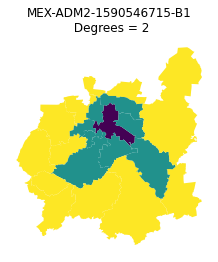

In [110]:
n = SpatialGraph("MEX-ADM2-1590546715-B1", gdf, df, degrees = 2)
n.show(box = False)

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


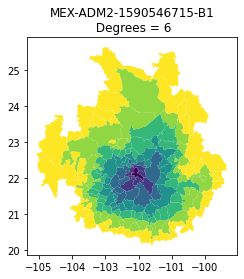

In [92]:
n = SpatialGraph("MEX-ADM2-1590546715-B1", gdf, df, degrees = 6)
n.show()

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


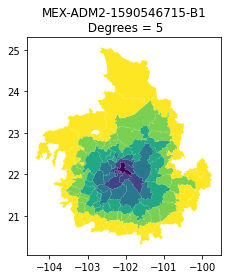

In [72]:
n = SpatialGraph("MEX-ADM2-1590546715-B1", gdf, df, degrees = 5)
n.show()

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


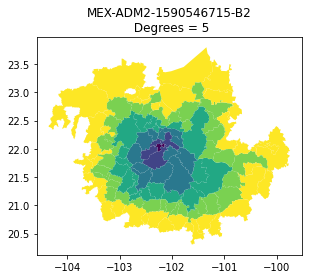

In [74]:
n2 = SpatialGraph("MEX-ADM2-1590546715-B2", gdf, df, degrees = 5)
n2.show()

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


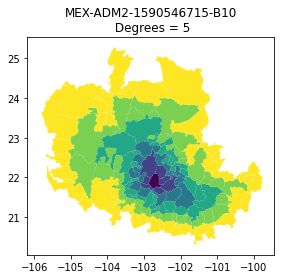

In [73]:
n3 = SpatialGraph("MEX-ADM2-1590546715-B10", gdf, df, degrees = 5)
n3.show()

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


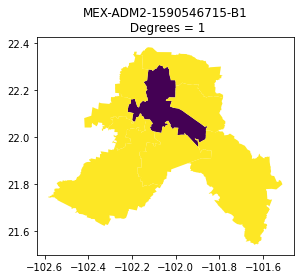

In [75]:
n1a = SpatialGraph("MEX-ADM2-1590546715-B1", gdf, df, degrees = 1)
n1a.show()

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


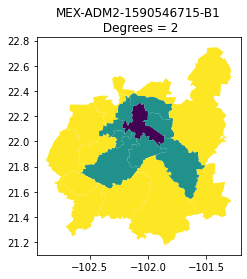

In [76]:
n1b = SpatialGraph("MEX-ADM2-1590546715-B1", gdf, df, degrees = 2)
n1b.show()

/home/hbaier/anaconda3/envs/caoe/lib/python3.7/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


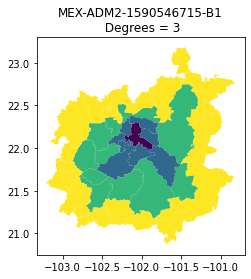

In [77]:
n1c = SpatialGraph("MEX-ADM2-1590546715-B1", gdf, df, degrees = 3)
n1c.show()